In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

# Limpeza de dados

In [3]:
# Carregar os dados
df = pd.read_csv("C:\\Users\\luizo\\Downloads\\archive\\US_Accidents_March23.csv")

# Remover duplicatas
df.drop_duplicates(inplace=True)

# Preencher valores faltantes (exemplo: preencher com a média para colunas numéricas)
df.fillna({
    'Temperature(F)': df['Temperature(F)'].mean(),
    'Humidity(%)': df['Humidity(%)'].mean(),
    'Wind_Speed(mph)': df['Wind_Speed(mph)'].mean(),
}, inplace=True)

# Excluir colunas que não são relevantes para a análise
df.drop(columns=['ID', 'Source', 'Description', 'Street', 'Zipcode', 'Country', 'Airport_Code'], inplace=True)
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns

# Análise Exploratória

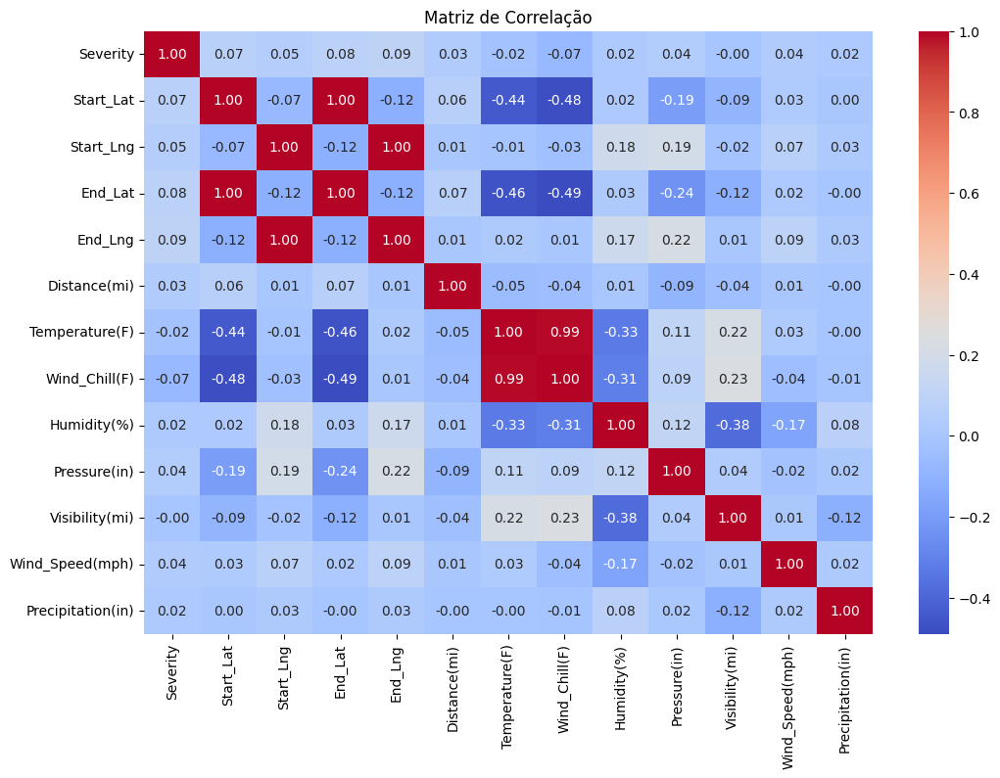

In [4]:
plt.figure(figsize=(12, 8))
correlation_matrix = df[numeric_columns].corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()

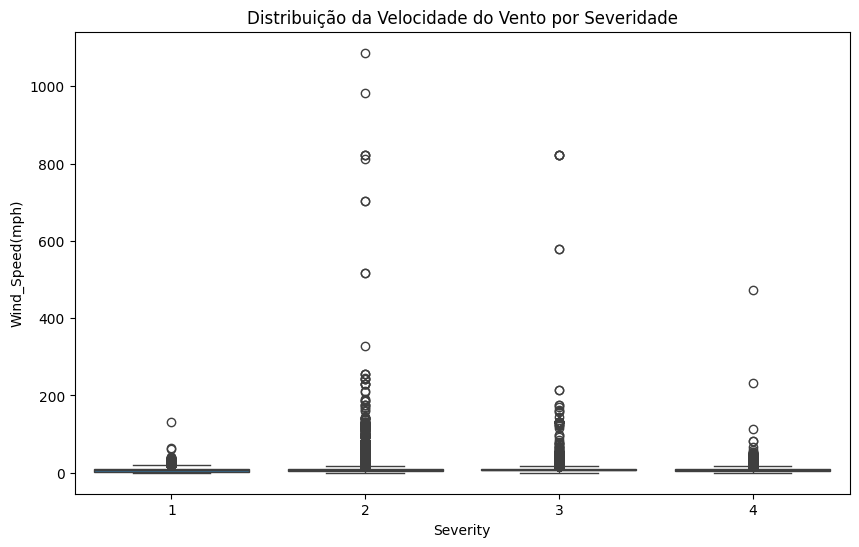

In [5]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Severity', y='Wind_Speed(mph)', data=df)
plt.title('Distribuição da Velocidade do Vento por Severidade')
plt.show()

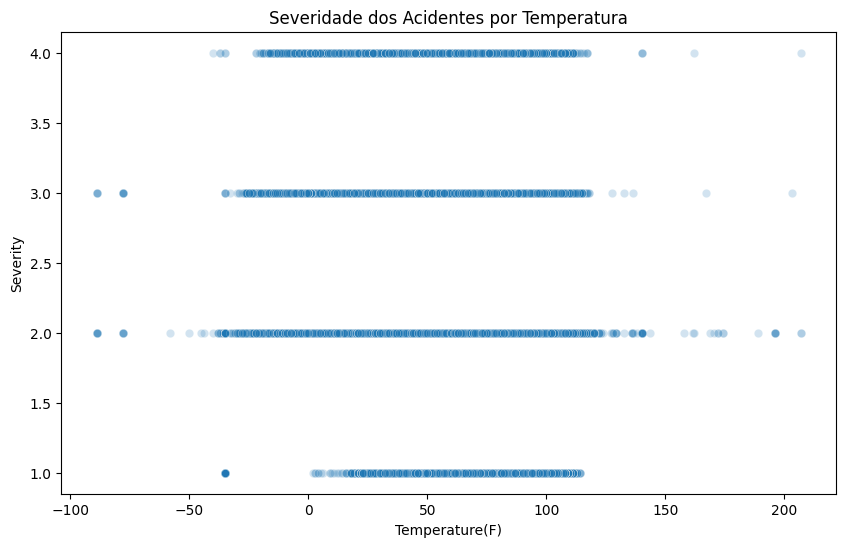

In [6]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Temperature(F)', y='Severity', data=df, alpha=0.2)
plt.title('Severidade dos Acidentes por Temperatura')
plt.show()

In [7]:
accidents_severe = df[df['Severity'] == 4]

# 2. Criar o mapa interativo
fig = px.scatter_mapbox(accidents_severe, 
                        lat="Start_Lat", 
                        lon="Start_Lng", 
                        hover_name="City", 
                        hover_data=["State", "Severity", "Temperature(F)", "Weather_Condition"],
                        color_discrete_sequence=["red"], 
                        zoom=5, 
                        height=600,
                        title="Acidentes mais graves (Severidade 4)")

# Configurar o estilo do mapa
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# Mostrar o mapa interativo
fig.show()

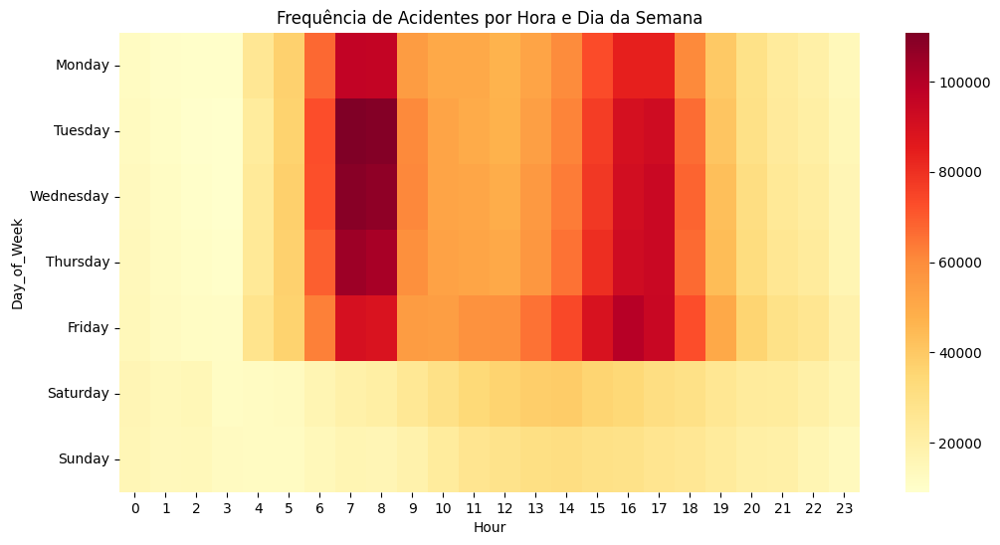

In [13]:

df['Start_Time'] = pd.to_datetime(df['Start_Time'], errors='coerce')

df = df.dropna(subset=['Start_Time'])

df['Day_of_Week'] = df['Start_Time'].dt.day_name()
df['Hour'] = df['Start_Time'].dt.hour

accidents_by_time = df.groupby(['Day_of_Week', 'Hour']).size().reset_index(name='Accident_Count')

days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
accidents_by_time['Day_of_Week'] = pd.Categorical(accidents_by_time['Day_of_Week'], categories=days_order, ordered=True)

accidents_pivot = accidents_by_time.pivot(index='Day_of_Week', columns='Hour', values='Accident_Count')

plt.figure(figsize=(12, 6))
sns.heatmap(accidents_pivot, cmap='YlOrRd', annot=False)
plt.title('Frequência de Acidentes por Hora e Dia da Semana')
plt.show()
